In [12]:
import numpy as np
import plotly.graph_objs as go
import plotly.io as pio
import matplotlib.pyplot as plt

In [9]:
# function and its gradient
def f(x, y):
    return -x**2 - y**2 + 3

def grad_f(x, y):
    return np.array([-2*x, -2*y])

# meshgrid for plotting
x = np.linspace(-2, 2, 400)
y = np.linspace(-2, 2, 400)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)

x0, y0 = 1, 1
z0 = f(x0, y0)

grad = grad_f(x0, y0)

# tangent plane
Z_tangent = z0 + grad[0] * (X - x0) + grad[1] * (Y - y0)

# partial derivatives of the function
def partial_x(x, y):
    return -2 * x

def partial_y(x, y):
    return -2 * y

x_tangent_line = x
z_tangent_x = z0 + partial_x(x_tangent_line, y0) * (x_tangent_line - x0)

y_tangent_line = y
z_tangent_y = z0 + partial_y(x0, y_tangent_line) * (y_tangent_line - y0)

surface = go.Surface(z=Z, x=X, y=Y, colorscale='Viridis', opacity=0.7, showscale=False)
tangent_plane = go.Surface(z=Z_tangent, x=X, y=Y, colorscale='Reds', opacity=0.5, showscale=False)
tangent_point = go.Scatter3d(x=[x0], y=[y0], z=[z0], mode='markers', marker=dict(size=5, color='red'))
tangent_line_x = go.Scatter3d(x=x_tangent_line, y=y0 * np.ones_like(x), z=z_tangent_x, mode='lines', line=dict(color='blue', width=3), name='Slice in x direction')
tangent_line_y = go.Scatter3d(x=x0 * np.ones_like(y), y=y_tangent_line, z=z_tangent_y, mode='lines', line=dict(color='green', width=3), name='Slice in y direction')

data = [surface, tangent_plane, tangent_point, tangent_line_x, tangent_line_y]

layout = go.Layout(scene=dict(
                    xaxis_title='X',
                    yaxis_title='Y',
                    zaxis_title='f(X, Y)'))


fig = go.Figure(data=data, layout=layout)
# pio.show(fig)


In [11]:
def f(x, y):
    return -x**2 - y**2 + 3

def grad_f(x, y):
    return np.array([-2*x, -2*y])

x = np.linspace(-2, 2, 400)
y = np.linspace(-2, 2, 400)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)
x0, y0 = 1, 1
z0 = f(x0, y0)

grad = grad_f(x0, y0)

Z_tangent = z0 + grad[0] * (X - x0) + grad[1] * (Y - y0)

def partial_x(x, y):
    return -2 * x

def partial_y(x, y):
    return -2 * y

x_tangent_line = x
z_tangent_x = z0 + partial_x(x0, y0) * (x_tangent_line - x0)

y_tangent_line = y
z_tangent_y = z0 + partial_y(x0, y0) * (y_tangent_line - y0)

surface = go.Surface(z=Z, x=X, y=Y, colorscale='Viridis', opacity=0.7, showscale=False)
tangent_plane = go.Surface(z=Z_tangent, x=X, y=Y, colorscale='Reds', opacity=0.5, showscale=False)
tangent_point = go.Scatter3d(x=[x0], y=[y0], z=[z0], mode='markers', marker=dict(size=5, color='red'))
tangent_line_x = go.Scatter3d(x=x_tangent_line, y=y0 * np.ones_like(x), z=z_tangent_x, mode='lines', line=dict(color='blue', width=3), name='Tangente in Richtung x')
tangent_line_y = go.Scatter3d(x=x0 * np.ones_like(y), y=y_tangent_line, z=z_tangent_y, mode='lines', line=dict(color='green', width=3), name='Tangente in Richtung y')

data = [surface, tangent_plane, tangent_point, tangent_line_x, tangent_line_y]

layout = go.Layout(scene=dict(
                    xaxis_title='X',
                    yaxis_title='Y',
                    zaxis_title='f(X, Y)'))

fig = go.Figure(data=data, layout=layout)
# pio.show(fig)



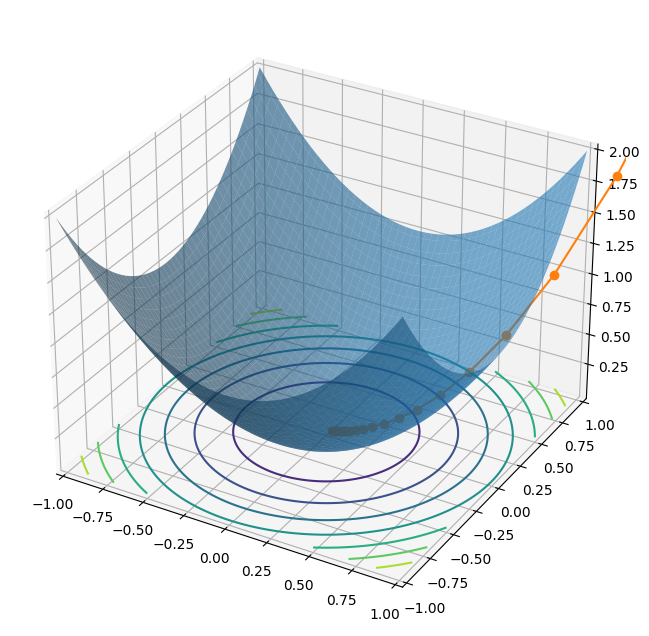

In [28]:
def fun(x, y):
    return x**2 + y**2
def gradient(x, y):
    return np.array([2*x, 2*y])
def gradient_descend(gradient, step_size=0.2, num_steps=30):
    lst = []
    x = np.random.uniform(0, 3, size = 2)
    lst.append(x)
    for i in range(num_steps):
        x = x - step_size * gradient(lst[-1][0], lst[-1][1])
        lst.append(x)
    return np.array(lst)

def plot_grad(fun, trace):
    fig = plt.figure(figsize=(10, 8))
    x_ = np.linspace(-1, 1, 100)
    y_ = np.linspace(-1, 1, 100)
    x, y = np.meshgrid(x_, y_)
    z = fun(x, y)
    ax = fig.add_subplot(1, 1, 1, projection='3d')
    ax.plot_surface(x, y, z, alpha=0.6)
    ax.contour(x, y, z, zdir='z', offset=z.min())
    z_trace = fun(trace[:, 0], trace[:, 1])
    ax.plot(trace[:, 0], trace[:, 1], z_trace, "o-")
    ax.set_xlim(x.min(), x.max())
    ax.set_ylim(y.min(), y.max())
    ax.set_zlim(z.min(), z.max())

trace = gradient_descend(grad, 0.1, 20)
plot_grad(fun, trace = trace)

Initial point: [2 2]
Iteration 1: Point = [1.6 1.6]
Iteration 2: Point = [1.28 1.28]
Iteration 3: Point = [1.024 1.024]
Iteration 4: Point = [0.8192 0.8192]
Iteration 5: Point = [0.65536 0.65536]
Iteration 6: Point = [0.524288 0.524288]
Iteration 7: Point = [0.4194304 0.4194304]
Iteration 8: Point = [0.33554432 0.33554432]
Iteration 9: Point = [0.26843546 0.26843546]
Iteration 10: Point = [0.21474836 0.21474836]
Iteration 11: Point = [0.17179869 0.17179869]
Iteration 12: Point = [0.13743895 0.13743895]
Iteration 13: Point = [0.10995116 0.10995116]
Iteration 14: Point = [0.08796093 0.08796093]
Iteration 15: Point = [0.07036874 0.07036874]
Iteration 16: Point = [0.056295 0.056295]
Iteration 17: Point = [0.045036 0.045036]
Iteration 18: Point = [0.0360288 0.0360288]
Iteration 19: Point = [0.02882304 0.02882304]
Iteration 20: Point = [0.02305843 0.02305843]


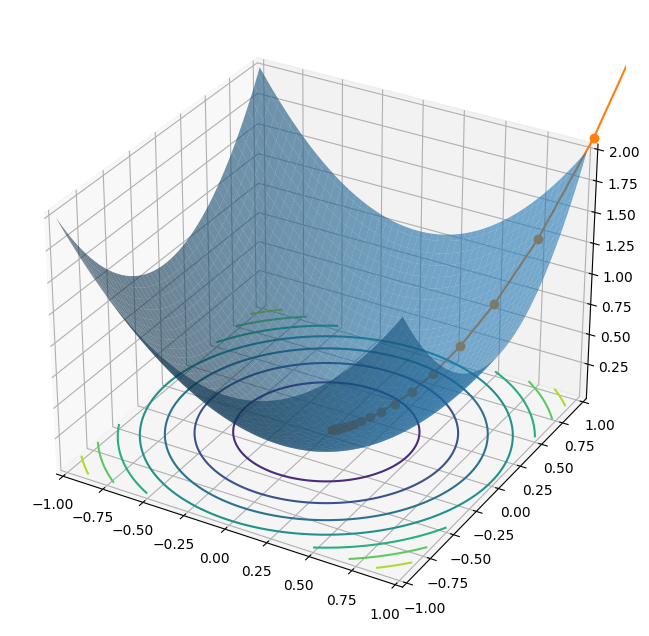

In [30]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

def fun(x, y):
    return x**2 + y**2

def gradient(x, y):
    return np.array([2*x, 2*y])

def gradient_descend(gradient, step_size=0.2, num_steps=30):
    lst = []
    x = np.array([2, 2])  # initial point (2, 2)
    lst.append(x)
    print("Initial point:", x)
    for i in range(num_steps):
        x = x - step_size * gradient(lst[-1][0], lst[-1][1])
        lst.append(x)
        print(f"Iteration {i+1}: Point = {x}")
    return np.array(lst)

def plot_grad(fun, trace):
    fig = plt.figure(figsize=(10, 8))
    x_ = np.linspace(-1, 1, 100)
    y_ = np.linspace(-1, 1, 100)
    x, y = np.meshgrid(x_, y_)
    z = fun(x, y)
    ax = fig.add_subplot(1, 1, 1, projection='3d')
    ax.plot_surface(x, y, z, alpha=0.6)
    ax.contour(x, y, z, zdir='z', offset=z.min())
    z_trace = fun(trace[:, 0], trace[:, 1])
    ax.plot(trace[:, 0], trace[:, 1], z_trace, "o-")
    ax.set_xlim(x.min(), x.max())
    ax.set_ylim(y.min(), y.max())
    ax.set_zlim(z.min(), z.max())
    plt.show()

# Example usage
trace = gradient_descend(gradient, 0.1, 20)
plot_grad(fun, trace=trace)